In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
# !wget https://artbench.eecs.berkeley.edu/files/artbench-10-imagefolder-split.tar

In [3]:
# import tarfile
# tar_file_path = "/kaggle/working/artbench-10-imagefolder-split.tar"
# output_dir = "/kaggle/working/"

# # Open the tar file
# with tarfile.open(tar_file_path, 'r') as tar:
#     # Extract all the contents of the tar file to the output directory
#     tar.extractall(output_dir)
#     print("Extraction completed.")

In [4]:
import torch
from torch import nn
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.utils as vutils

# Define hyperparameters
epochs = 70
batch_size = 256
learning_rate = 0.0002
image_size = 128
channels = 3 # RGB images
latent_dim = 100
features_gen = 64
features_dis = 64

# Load and preprocess the ArtBench10 dataset
transform = transforms.Compose([transforms.Resize(image_size),
                                transforms.CenterCrop(image_size),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

dataset = ImageFolder(root='artbench-10-imagefolder-split/train', transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=15)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("device: ", device)

device:  cuda


In [5]:
!pip install torchsummary

Defaulting to user installation because normal site-packages is not writeable


In [6]:
from torchsummary import summary
class Generator3x128x128(nn.Module):
    def __init__(self, latent_dim):
        super(Generator3x128x128, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # state size. 512 x 4 x 4
            nn.ConvTranspose2d(512, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            # state size. 512 x 8 x 8
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            # state size. 256 x 16 x 16
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            # state size. 128 x 32 x 32
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # state size. 64 x 64 x 64
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # final state size. 3 x 128 x 128
        )

    def forward(self, x):
        x = self.model(x)
        return x

netG = Generator3x128x128(latent_dim).to(device)
print("Generator Summary")
print(summary(netG, (latent_dim, 1, 1)))

class Discriminator3x128x128(nn.Module):
    def __init__(self):
        super(Discriminator3x128x128, self).__init__()
        self.model = nn.Sequential(
            # input is 3 x 128 x 128
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. 64 x 64 x 64
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. 128 x 32 x 32
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. 256 x 16 x 16
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. 512 x 8 x 8
            nn.Conv2d(512, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. 512 x 4 x 4
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.model(x)
        return x

netD = Discriminator3x128x128().to(device)
print("Discriminator Summary")
print(summary(netD, (3, 128, 128)))


Generator Summary
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]         819,200
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 512, 8, 8]       4,194,304
       BatchNorm2d-5            [-1, 512, 8, 8]           1,024
              ReLU-6            [-1, 512, 8, 8]               0
   ConvTranspose2d-7          [-1, 256, 16, 16]       2,097,152
       BatchNorm2d-8          [-1, 256, 16, 16]             512
              ReLU-9          [-1, 256, 16, 16]               0
  ConvTranspose2d-10          [-1, 128, 32, 32]         524,288
      BatchNorm2d-11          [-1, 128, 32, 32]             256
             ReLU-12          [-1, 128, 32, 32]               0
  ConvTranspose2d-13           [-1, 64, 64, 64]         131,072
      BatchNorm2d-14 

In [7]:
# Define the optimizers and the loss (BCELoss)
optimizerD = torch.optim.Adam(netD.parameters(), lr=learning_rate, betas=(0.5, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=learning_rate, betas=(0.5, 0.999))

criterion = nn.BCELoss()

fixed_noise = torch.randn(64, latent_dim, 1, 1, device=device)

real_label = 1
fake_label = 0

img_list = []
G_losses = []
D_losses = []
iters = 0

In [8]:
real_label = 1
fake_label = 0

# Training loop
for epoch in range(epochs):
    for i, data in enumerate(dataloader, 0):
        netG.train()
        netD.train()
        
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, latent_dim, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()

        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()

        optimizerG.step()

        print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f'
              % (epoch, epochs, i, len(dataloader),
                 errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters+=1

[0/70][0/196] Loss_D: 1.4594 Loss_G: 5.9406 D(x): 0.4685 D(G(z)): 0.4884 / 0.0029
[0/70][1/196] Loss_D: 1.9924 Loss_G: 7.0653 D(x): 0.7274 D(G(z)): 0.7986 / 0.0010
[0/70][2/196] Loss_D: 1.6505 Loss_G: 4.6004 D(x): 0.3594 D(G(z)): 0.2636 / 0.0107
[0/70][3/196] Loss_D: 3.0630 Loss_G: 7.8071 D(x): 0.7001 D(G(z)): 0.9244 / 0.0005
[0/70][4/196] Loss_D: 0.8942 Loss_G: 6.2270 D(x): 0.5596 D(G(z)): 0.1302 / 0.0022
[0/70][5/196] Loss_D: 2.1674 Loss_G: 9.7075 D(x): 0.7391 D(G(z)): 0.8273 / 0.0001
[0/70][6/196] Loss_D: 0.7587 Loss_G: 7.1766 D(x): 0.5620 D(G(z)): 0.0177 / 0.0009
[0/70][7/196] Loss_D: 2.2119 Loss_G: 10.1267 D(x): 0.7865 D(G(z)): 0.8470 / 0.0000
[0/70][8/196] Loss_D: 0.5760 Loss_G: 8.6693 D(x): 0.6211 D(G(z)): 0.0043 / 0.0002
[0/70][9/196] Loss_D: 0.8884 Loss_G: 8.9277 D(x): 0.7146 D(G(z)): 0.3700 / 0.0001
[0/70][10/196] Loss_D: 0.4643 Loss_G: 8.1021 D(x): 0.7575 D(G(z)): 0.1316 / 0.0003
[0/70][11/196] Loss_D: 1.3230 Loss_G: 11.9146 D(x): 0.8201 D(G(z)): 0.6549 / 0.0000
[0/70][12/19

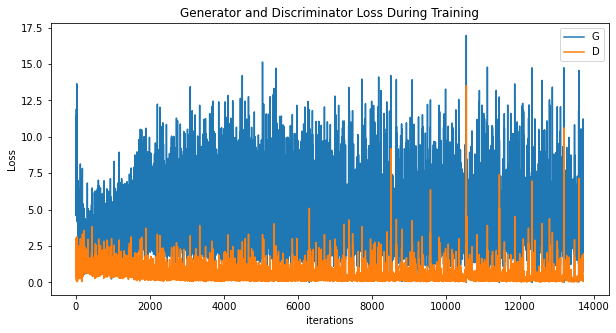

In [9]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


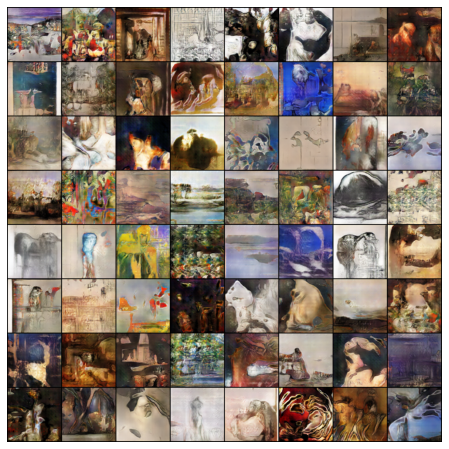

In [10]:
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Animation size has reached 21929834 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


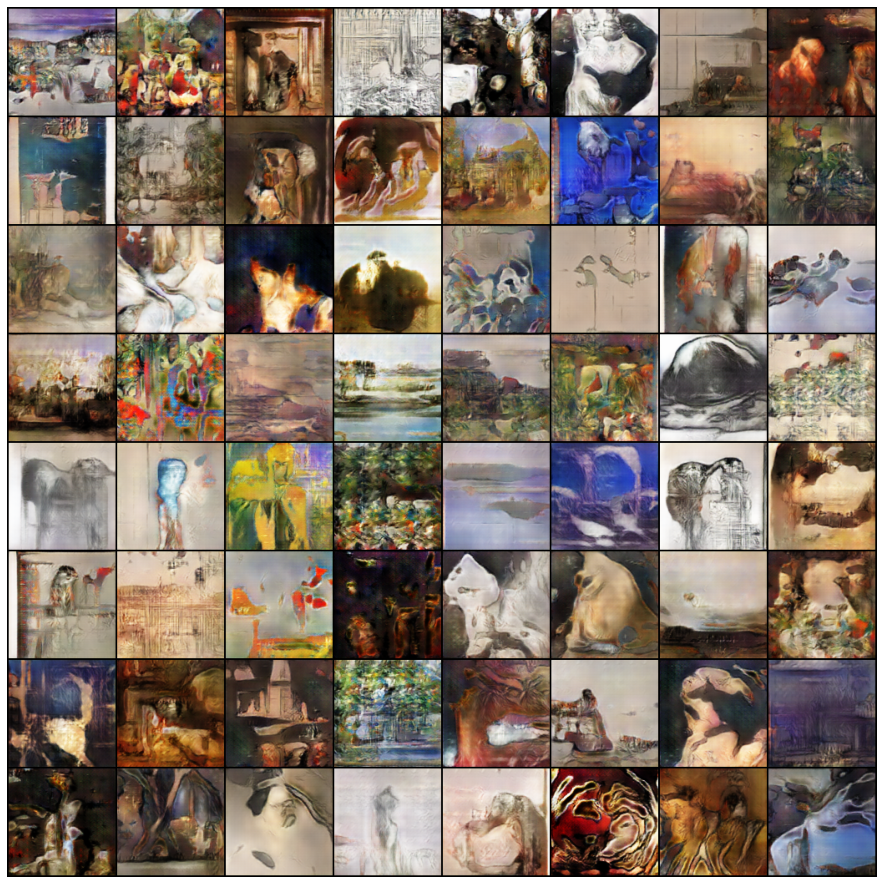

In [92]:
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(16,16))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [11]:
# Save the models
torch.save(netG.state_dict(), 'generator.pth')
torch.save(netD.state_dict(), 'discriminator.pth')

In [ ]:
netG.load_state_dict(torch.load('generator.pth'))
netD.load_state_dict(torch.load('discriminator.pth'))

In [80]:
from ignite.metrics import FID, InceptionScore

In [81]:
fid_metric = FID(device=device)

In [82]:
is_metric = InceptionScore(device=device, output_transform=lambda x: x[0])

In [83]:
import PIL.Image as Image


def interpolate(batch):
    arr = []
    for img in batch:
        pil_img = transforms.ToPILImage()(img)
        resized_img = pil_img.resize((299,299), Image.BILINEAR)
        arr.append(transforms.ToTensor()(resized_img))
    return torch.stack(arr)


def evaluation_step(engine, batch):
    with torch.no_grad():
        actual_batch_size = batch[0].size(0)
        noise = torch.randn(actual_batch_size, latent_dim, 1, 1, device=device)
        netG.eval()
        fake_batch = netG(noise)
        fake = interpolate(fake_batch)
        real = interpolate(batch[0])
        return fake, real

In [84]:
from ignite.engine import Engine, Events
from ignite.contrib.handlers import ProgressBar

evaluator = Engine(evaluation_step)
fid_metric.attach(evaluator, "fid")
is_metric.attach(evaluator, "is")
# Create a progress bar object
pbar = ProgressBar(persist=True)

# Attach progress bar to evaluator
pbar.attach(evaluator)

In [85]:
transform = transforms.Compose([transforms.Resize(image_size),
                                transforms.CenterCrop(image_size),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

test_dataset = ImageFolder(root='artbench-10-imagefolder-split/test', transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=True, num_workers=15)


In [86]:
print(image_size)

128


In [87]:
@evaluator.on(Events.ITERATION_STARTED(every=10))
def log_training_loss(engine):
    print(f"Epoch[{engine.state.epoch}] Iteration[{engine.state.iteration}] Loss: {engine.state.output}")


evaluator.run(test_dataloader,max_epochs=1)
metrics = evaluator.state.metrics
fid_score = metrics['fid']
is_score = metrics['is']
print("fid_score", fid_score)
print("is_score", is_score)

[1/40]   2%|2          [00:00<?]

Epoch[1] Iteration[10] Loss: None
Epoch[1] Iteration[20] Loss: None
Epoch[1] Iteration[30] Loss: None
Epoch[1] Iteration[40] Loss: None
fid_score 0.022108695394127298
is_score 2.6547550603999617


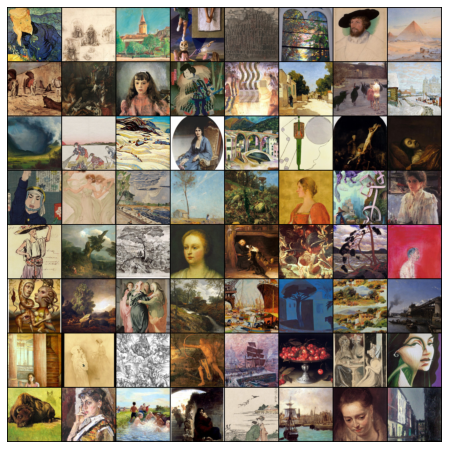

In [91]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Assuming that you have loaded data from train_dataloader
dataiter = iter(dataloader)
images, _ = dataiter.next()

# Normalize the images for display
img_grid = vutils.make_grid(images[:64], padding=2, normalize=True)

# Transpose the image grid for displaying
img_grid = np.transpose(img_grid, (1, 2, 0))

plt.figure(figsize=(8, 8))
plt.axis("off")
plt.imshow(img_grid)
plt.show()

In [94]:
from ignite.metrics import FID, InceptionScore
fid_metric = FID(device=device)
is_metric = InceptionScore(device=device, output_transform=lambda x: x[0])

import PIL.Image as Image


def evaluation_step_new(engine, batch):
    with torch.no_grad():
        actual_batch_size = batch[0].size(0)
        noise = torch.randn(actual_batch_size, latent_dim, 1, 1, device=device)
        netG.eval()
        fake_batch = netG(noise)
        fake = fake_batch
        real = batch[0]
        return fake, real

from ignite.engine import Engine, Events
from ignite.contrib.handlers import ProgressBar

evaluator = Engine(evaluation_step_new)
fid_metric.attach(evaluator, "fid")
is_metric.attach(evaluator, "is")
# Create a progress bar object
pbar = ProgressBar(persist=True)

# Attach progress bar to evaluator
pbar.attach(evaluator)

transform = transforms.Compose([transforms.Resize(image_size),
                                transforms.CenterCrop(image_size),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

test_dataset = ImageFolder(root='artbench-10-imagefolder-split/test', transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=True, num_workers=15)

@evaluator.on(Events.ITERATION_STARTED(every=10))
def log_training_loss(engine):
    print(f"Epoch[{engine.state.epoch}] Iteration[{engine.state.iteration}] Loss: {engine.state.output}")


evaluator.run(test_dataloader,max_epochs=1)
metrics = evaluator.state.metrics
fid_score = metrics['fid']
is_score = metrics['is']
print("fid_score", fid_score)
print("is_score", is_score)

[1/40]   2%|2          [00:00<?]

Epoch[1] Iteration[10] Loss: None
Epoch[1] Iteration[20] Loss: None
Epoch[1] Iteration[30] Loss: None
Epoch[1] Iteration[40] Loss: None
fid_score 0.1562394577335805
is_score 76.5181117284821
